<a href="https://colab.research.google.com/github/Karenw1004/Deeppicar-v3/blob/main/RunAll.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
try:
  # %tensorflow_version only exists in Colab.
  %tensorflow_version 2.x
except Exception:
  pass

In [ ]:
import tensorflow as tf
from cv2 import cv2
import sys
import os
import time
import math
import numpy as np
from tqdm import tqdm
from glob import glob
import pandas as pd
import zipfile
import pathlib
from keras.preprocessing import image

# Download dataset to google colab instance

In [ ]:
!wget --no-check-certificate --no-clobber https://raw.githubusercontent.com/Karenw1004/Deeppicar-v3/main/Dataset.zip

--2021-03-17 19:27:02--  https://raw.githubusercontent.com/Karenw1004/Deeppicar-v3/main/Dataset.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 69313921 (66M) [application/zip]
Saving to: ‘Dataset.zip’

Dataset.zip         100%[===================>]  66.10M  99.2MB/s    in 0.7s    

2021-03-17 19:27:05 (99.2 MB/s) - ‘Dataset.zip’ saved [69313921/69313921]



In [ ]:
list_zip = glob("./*.zip")
print(list_zip)
local_zip_file_path = list_zip[0]
print(local_zip_file_path)

zip_ref = zipfile.ZipFile(local_zip_file_path)
data_dir = local_zip_file_path.replace(".zip","")
print(data_dir)
zip_ref.extractall(data_dir)
print("The Dataset folder has been added to the colab instance")

['./Dataset.zip']
./Dataset.zip
./Dataset
The Dataset folder has been added to the colab instance


# Preprocess dataset video to frames

In [ ]:
# Config
NFRAMES = 1000

img_height = 66
img_width =  200
img_channels = 3
input_shape = [ img_height, img_width, img_channels]

In [ ]:
!mkdir $data_dir/train_images

In [ ]:
vid_ext = ".avi"
all_video_files = glob(f"{data_dir}/*{vid_ext}")

for path in tqdm(all_video_files):
  
  # Open the video file
  assert os.path.isfile(path)
  cap = cv2.VideoCapture(path)

  curFrame = 0
  vid_name = path.split("/")[-1]
  vid_name = vid_name.split(".")[0]

  while (cap.isOpened()):
    if curFrame < NFRAMES:
      cam_start = time.time()
      ret, img = cap.read()

      if cv2.waitKey(1) & 0xFF == ord('q'):
        break

      curFrame += 1
      filename = f"train_images/{vid_name}_frame_{curFrame}.jpg" 
      frame = img
      cv2.imwrite(f"{data_dir}/{filename}", frame)

    else:
      break

cap.release()
cv2.destroyAllWindows()

100%|██████████| 11/11 [00:21<00:00,  2.00s/it]


<font color='blue'>NOTE</font><br/>
You can click on the files on the left.<br/>
> Files -> Dataset -> train_images
<br/>

It will have the 11000 frames images where each video produce 1000 frames images (not yet preprocess)


# Load Data


## Load the csv files 

In [ ]:
all_csv_files = glob("./Dataset/*.csv")
df_dict = {}
print(all_csv_files)
for filepath in all_csv_files:
  df = pd.read_csv(filepath, index_col=None,header=0)
  filename = filepath.split("/")[-1]
  out_number = filename.split("-")[-1]
  out_number = int(out_number.split(".")[0])
  df_dict[out_number] = df

['./Dataset/out-key-5.csv', './Dataset/out-key-0.csv', './Dataset/out-key-10.csv', './Dataset/out-key-4.csv', './Dataset/out-key-1.csv', './Dataset/out-key-9.csv', './Dataset/out-key-6.csv', './Dataset/out-key-7.csv', './Dataset/out-key-8.csv', './Dataset/out-key-2.csv', './Dataset/out-key-3.csv']


In [ ]:
df_dict.keys()

dict_keys([5, 0, 10, 4, 1, 9, 6, 7, 8, 2, 3])

Looks great! We have all the 11 csv files !

### Let's check out the csv data 

In [ ]:
df = df_dict[0]
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   ts_micro  1000 non-null   int64  
 1   frame     1000 non-null   int64  
 2   wheel     1000 non-null   float64
dtypes: float64(1), int64(2)
memory usage: 23.6 KB


**Very clean** data with no nulls value and no missing value

In [ ]:
df.wheel.unique()

array([ 0.        ,  0.52359878, -0.52359878])


| Column | Explanation |
| --- | --- |
| ts_micro | TODO: EXPLAIN THIS |
| frame | the current frame number  |
| wheel | **- 0.52359878 rad == 30 degrees** representing turning **right**|
|| **0 rad == 0 degrees** representing **center** |
|| **-0.52359878 rad == -30 degrees** reprsent turning **left**  |


# Preprocess the frames images

In [ ]:
def preprocess(img):
  assert img_channels == 3 # for now we expect a color image
  img = cv2.resize(img, (img_width, img_height))
  img = img / 255.
  return img

In [ ]:
images = glob(f"{data_dir}/train_images/*.jpg")
train_image_path = []
train_image = []
train_wheel_val = []

for i in tqdm(range(len(images))):

  image_path = images[i]
  train_image_path.append(image_path)

  img = image.load_img(image_path)
  img = image.img_to_array(img)
  img = preprocess(img)
  train_image.append(img)

  out_number = images[i].split("-")[-1]
  out_number = int(out_number.split("_")[0])
  df = df_dict[out_number]

  frame_number = images[i].split("_")[-1]
  frame_number = int(frame_number.split(".")[0])
  df_row = df[ df['frame'] == frame_number ]
  data = df_row['wheel']
  train_wheel_val.append(float(data))


100%|██████████| 11000/11000 [00:33<00:00, 327.30it/s]


In [ ]:
train_df = pd.DataFrame()
train_df['image_path'] = train_image_path
train_df['wheel'] = train_wheel_val
train_df['image'] = train_image
train_df.head()

,image_path,wheel,image
0,./Dataset/train_images/out-video-6_frame_79.jpg,0.000000,"[[[0.5226382, 0.54224604, 0.52655977], [0.5351..."
1,./Dataset/train_images/out-video-9_frame_484.jpg,0.523599,"[[[0.2536542, 0.17324421, 0.07351159], [0.2571..."
2,./Dataset/train_images/out-video-7_frame_228.jpg,0.523599,"[[[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0,..."
3,./Dataset/train_images/out-video-10_frame_239.jpg,0.523599,"[[[0.4678431, 0.49137256, 0.48352942], [0.4705..."
4,./Dataset/train_images/out-video-1_frame_807.jpg,0.523599,"[[[0.15213904, 0.08037433, 0.005472371], [0.15..."


In [ ]:
X = np.array(train_image)
X.shape

(11000, 66, 200, 3)

Currently there is 11000 images with size of (66,200,3)<br>
- img_height = 66
- img_width =  200
- img_channels = 3  (RGB color)

In [ ]:
y = train_df['wheel'] 
y.shape

(11000,)

## Split the dataset to 60% train, 20% validation, 20% test

In [ ]:
def split_stratified_into_train_val_test(X, y,
                                         frac_train, frac_val, frac_test,
                                         random_state=7):
  if frac_train + frac_val + frac_test != 1.0:
      raise ValueError(f"Train {frac_train} + val {frac_val} + test {frac_test} doesnt add up to 1!")

  X_train, X_temp, y_train, y_temp = train_test_split(X,y,
                                                        stratify=y,
                                                        test_size=(1.0 - frac_train),
                                                        random_state=random_state)

  remaining_frac = frac_test / (frac_val + frac_test)
  X_val, X_test, y_val, y_test = train_test_split(X_temp,
                                                    y_temp,
                                                    stratify=y_temp,
                                                    test_size=remaining_frac,
                                                    random_state=random_state)

  assert y.shape[0] == len(X_train) + len(X_val) + len(X_test)

  return X_train, y_train, X_val, y_val, X_test, y_test

In [ ]:
from sklearn.model_selection import train_test_split

X_train, y_train,X_val, y_val, X_test, y_test = split_stratified_into_train_val_test(X,y,0.6,0.2,0.2)

<img src="https://docs.google.com/drawings/d/e/2PACX-1vQ0bab0CSt7NH_jfCPIG5FghYA7WBBVZMPE06OEFPUeab5WQ-XKhe3Ys_i72EefgE0hSnwwjErhU60c/pub?w=960&amp;h=720">

<font color='blue'>NOTE</font><br/>
Just change the google drawing, you do **NOT** need to upload new pictures to github everytime you change the drawing because it is published to web (so the embeeded image link is always the same unless you clicked the unpublished web button

# Define model 

## Layers


The overall model look like this<br>
<img src='https://drive.google.com/uc?export=view&id=1ly2QuhyzF_DFADSfMPplvPk8u0ZuIm1c'
width='300px' height='300x'> <br>
And from tensorflow-v1:<br>
<img src='https://drive.google.com/uc?export=view&id=1fq4k7SnE-O1o3gppNjw8SumixwnpHZ_0' >


In [ ]:
# Config
img_height = 66
img_width =  200
img_channels = 3
input_shape = [ img_height, img_width, img_channels]

In [ ]:
# To make sure there is no inqeuivalent output from tf.nn.conv2d and keras.layers.Conv2D
# ref:https://stackoverflow.com/questions/61087933/inequivalent-output-from-tf-nn-conv2d-and-keras-layers-conv2d
tf.keras.backend.set_floatx('float32')

# Model 5 conv 3fc

#Input layer
input_x = tf.keras.layers.Conv2D(filters=3, kernel_size=[5,5], input_shape=input_shape,activation='relu',  padding="same")
input_max = tf.keras.layers.MaxPooling2D(5,2)

# 1st convolution layer
h_conv1 = tf.keras.layers.Conv2D(filters=24, kernel_size=[5,5], input_shape= input_shape,activation='relu',  padding="same")
h_max1 = tf.keras.layers.MaxPooling2D(5,2)

# 2nd convolution layer
h_conv2 = tf.keras.layers.Conv2D(filters=36, kernel_size=[5,5], activation='relu', padding="same") 
h_max2 = tf.keras.layers.MaxPooling2D(5,2)

# 3rd convolution layer
h_conv3 = tf.keras.layers.Conv2D(filters=48, kernel_size=[5,5], activation='relu', padding="same") 
h_max3 = tf.keras.layers.MaxPooling2D(3,1)

# 4th convolution layer
h_conv4 = tf.keras.layers.Conv2D(filters=64, kernel_size=[3,3], activation='relu', padding="same") 
h_max4 = tf.keras.layers.MaxPooling2D(3,1)

# 5th convolution layer
h_conv5 = tf.keras.layers.Conv2D(filters=64, kernel_size=[3,3], activation='relu', padding="same") 
h_conv5_flat = tf.keras.layers.Flatten() #1152

#Fully connected layers
h_fc2 = tf.keras.layers.Dense(100, activation='relu')
h_fc3 = tf.keras.layers.Dense(50, activation='relu')
h_fc4 = tf.keras.layers.Dense(10, activation='relu')

h_y = tf.keras.layers.Dense(1, activation='tanh')
                

In [ ]:
# https://stackoverflow.com/questions/42785026/tf-nn-conv2d-vs-tf-layers-conv2d
model = tf.keras.models.Sequential([
            input_x,
            input_max,
            h_conv1,
            h_max1 ,
            h_conv2,
            h_max2,
            h_conv3,
            h_max3,
            h_conv4,
            h_max4,
            h_conv5,
            h_conv5_flat,
            h_fc2,
            h_fc3,
            h_fc4,
            h_y,
])

In [ ]:
print(model.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 66, 200, 3)        228       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 31, 98, 3)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 31, 98, 24)        1824      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 14, 47, 24)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 14, 47, 36)        21636     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 5, 22, 36)         0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 5, 22, 48)         4

## Compile the model with Adam optimizer and Mean Squared Error Loss


In [ ]:
from tensorflow.keras.losses import MeanSquaredError
from tensorflow.keras.optimizers import Adam
loss = MeanSquaredError()
opt = Adam(learning_rate= 1e-4)
model.compile(loss=loss, optimizer=opt)

## Add tensorboard and checkpoint callbacks
- Tensorboard callbacks is to view the loss value in tensorboard (scroll below to see the tensorboard)
- Checkpoint callbacks is to save the best model with the minimum loss value.

In [ ]:
import datetime
log_dir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir, histogram_freq=1)

model_filepath="./models/Deepicar-epoch-{epoch:02d}-loss-{val_loss:.4f}.hdf5"
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(model_filepath, monitor='val_loss',verbose=1, save_best_only=True, mode='min', save_freq='epoch')

## Fit the model with the given number of epoch

In [ ]:
# Config
epoch_num = 20
steps_per_epoch = 24

In [ ]:
model.fit(X_train, y_train, epochs=epoch_num, steps_per_epoch=steps_per_epoch,
          validation_data=(X_test, y_test), 
          batch_size=128,
          callbacks=[tensorboard_callback, checkpoint_callback])

Epoch 1/20
24/24 [==============================] - 59s 2s/step - loss: 0.1347 - val_loss: 0.1249

Epoch 00001: val_loss improved from inf to 0.12494, saving model to ./models/Deepicar-epoch-01-loss-0.1249.hdf5
Epoch 2/20
24/24 [==============================] - 58s 2s/step - loss: 0.1254 - val_loss: 0.1140

Epoch 00002: val_loss improved from 0.12494 to 0.11403, saving model to ./models/Deepicar-epoch-02-loss-0.1140.hdf5
Epoch 3/20
24/24 [==============================] - 60s 3s/step - loss: 0.1097 - val_loss: 0.0899

Epoch 00003: val_loss improved from 0.11403 to 0.08990, saving model to ./models/Deepicar-epoch-03-loss-0.0899.hdf5
Epoch 4/20
24/24 [==============================] - 60s 3s/step - loss: 0.0838 - val_loss: 0.0802

Epoch 00004: val_loss improved from 0.08990 to 0.08020, saving model to ./models/Deepicar-epoch-04-loss-0.0802.hdf5
Epoch 5/20
24/24 [==============================] - 60s 3s/step - loss: 0.0803 - val_loss: 0.0760

Epoch 00005: val_loss improved from 0.08020 t

### Delete the other checkpoints model and only keep the latest model which is the best
<font color='red'>WARNING</font><br/>
Do not combine the three cells below

In [ ]:
cd ./models/

/content/models


In [ ]:
# Delete all files excepted the last modified files for models directory
!find . -type f  -printf '%T@\t%p\0' | sort -zk1,1rn | cut -zf2 | tail -z -n +2 | xargs -0 rm -f

In [ ]:
cd ../

/content


# Tensorboard


In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

# Save the model 

In [ ]:
DEEPPICAR_MODEL_PATH = glob(f"./models/*")[0]
DEEPPICAR_MODEL_PATH

'./models/Deepicar-epoch-20-loss-0.0626.hdf5'

In [ ]:
# Config
model_path = "./models/Deeppicar-ori.hdf5"

In [ ]:
mv $DEEPPICAR_MODEL_PATH $model_path #rename models file name

# Load TFLite model and allocate tensors.

In [ ]:
import pathlib
DEEPPICAR_MODEL = tf.keras.models.load_model(model_path)
converter = tf.lite.TFLiteConverter.from_keras_model(DEEPPICAR_MODEL)

tflite_model = converter.convert()
tflite_models_dir = pathlib.Path("/tmp/")

tflite_model_file = tflite_models_dir/'model1.tflite'
tflite_model_file.write_bytes(tflite_model)
# This will report back the file size in bytes

INFO:tensorflow:Assets written to: /tmp/tmpi8yqrfk5/assets


1016148

In [ ]:
tflite_model_file = '/tmp/model1.tflite'
interpreter = tf.lite.Interpreter(model_path=tflite_model_file)
interpreter.allocate_tensors()

# Evaluate the model

In [ ]:
import math

def rad2deg(rad):
  return 180.0 * rad / math.pi

In [ ]:
def get_action(angle_rad):
  degree = rad2deg(angle_rad)
  if degree < 15 and degree > -15:
    return "center"
  elif degree >= 15:
    return "right" 
  elif degree <-15:
    return "left"

In [ ]:
predictions = []
test_labels, test_imgs = [], []

input_index = interpreter.get_input_details()[0]["index"]
output_index = interpreter.get_output_details()[0]["index"]

length = len(X_val)
accuracy = 0 
for i in tqdm(range(length)):
  img = X_val[i]
  img = np.expand_dims(img, axis=0).astype(np.float32)
  test_imgs.append(img)

  interpreter.set_tensor(input_index, img)
  # Run inference.
  interpreter.invoke()
  # Post-processing: remove batch dimension and find the digit with highest probability.

  predicted_angle = interpreter.get_tensor(output_index)[0][0]
  groundtrue_angle = y_val.iloc[i]
  predictions.append(predicted_angle)
  test_labels.append(groundtrue_angle)

  if get_action(predicted_angle) == get_action(groundtrue_angle):
    accuracy = accuracy + 1

print(f"\nAccuracy is {(accuracy/length)*100:.2f}%")

100%|██████████| 2200/2200 [00:23<00:00, 95.32it/s]


Accuracy is 70.23%


In [ ]:
import matplotlib.pylab as plt

  
def plot_image(i, prediction_array, groundtrue_array, img_array, match):
  predicted_angle, groundtrue_angle, img = prediction_array[i], groundtrue_array[i], img_array[i]

  predicted_label = get_action(predicted_angle)
  groundtrue_label = get_action(groundtrue_angle)
  
  # prediction (angle), prediction (action), ground truth (angle), ground truth (action), 
  # print(predicted_angle, groundtrue_angle, predicted_label, groundtrue_label)
  
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])
  
  img = np.squeeze(img)
  plt.imshow(img, cmap=plt.cm.binary)
  
  if predicted_label == groundtrue_label:
    color = 'green'
    match += 1
  else:
    color = 'red'
  
  plt.xlabel(f"{predicted_angle:.2f} {predicted_label}  Actual:{groundtrue_label}"
  , color=color)

  return match

# Visualisation

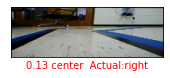

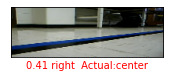

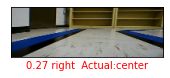

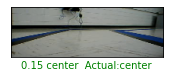

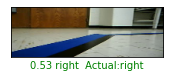

...

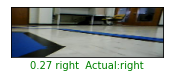

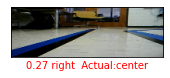

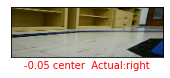

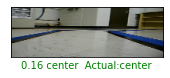

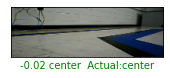

In [ ]:
#@title Visualize the outputs { run: "auto" }
index = 22 #@param {type:"slider", min:0, max:99, step:1}
accuracy = 0
for index in range(0,99):
  plt.figure(figsize=(6,3))
  plt.subplot(1,2,1)
  accuracy = plot_image(index, predictions, test_labels, test_imgs, accuracy)
  plt.show()

In [ ]:
print(f"Accuracy is {(accuracy/100)*100}%")

Accuracy is 70.0%


## Visualize the network

(66, 200, 3)
(1, 66, 200, 3)
15


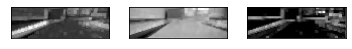

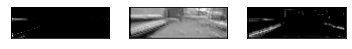

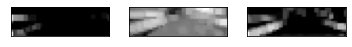

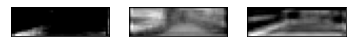

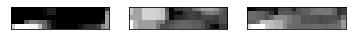

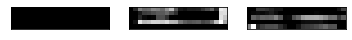

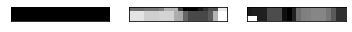

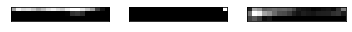

In [ ]:
from matplotlib import pyplot

img_path = images[0]
img = image.load_img(img_path, target_size=(img_height, img_width))  # this is a PIL image
img = image.img_to_array(img)  
print(img.shape)
img = np.expand_dims(img, axis=0)
print(img.shape)

successive_outputs = [layer.output for layer in model.layers[1:]]
visualization_model = tf.keras.models.Model(inputs = model.input, outputs = successive_outputs)
feature_maps = visualization_model.predict(img)
print(len(feature_maps))
square = 3
for fmap in feature_maps:
  if len(fmap.shape) == 4:
    ix = 1
    for _ in range(square):
      ax = pyplot.subplot(square, square, ix)
      ax.set_xticks([])
      ax.set_yticks([])
      # plot filter channel in grayscale
      pyplot.imshow(fmap[0, :, :, ix-1], cmap='gray')
      ix += 1
    # show the figure
    pyplot.show()

# Run Model

In [ ]:
!sudo apt-get install python3-magic

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  libmagic-mgc libmagic1
Suggested packages:
  file
The following NEW packages will be installed:
  libmagic-mgc libmagic1 python3-magic
0 upgraded, 3 newly installed, 0 to remove and 29 not upgraded.
Need to get 262 kB of archives.
After this operation, 5,257 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic-updates/main amd64 libmagic-mgc amd64 1:5.32-2ubuntu0.4 [184 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic-updates/main amd64 libmagic1 amd64 1:5.32-2ubuntu0.4 [68.6 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/main amd64 python3-magic all 2:0.4.15-1 [9,280 B]
Fetched 262 kB in 1s (253 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76

In [ ]:
!pip show python-magic

Name: python-magic
Version: 0.4.16
Summary: File type identification using libmagic
Home-page: http://github.com/ahupp/python-magic
Author: Adam Hupp
Author-email: adam@hupp.org
License: MIT
Location: /usr/lib/python3/dist-packages
Requires: 
Required-by: 


<font color='blue'>NOTE</font><br/>
Make sure you installed the readily available magic libray at PYPI as it is easily installed via pip into virtualenv environments.
As of the date of this documentation is created, there are two version of python-magic **python-magic-0.4.22** (recommended) and python-magic-5.19.1

In [ ]:
def get_classes(img):
  img = image.img_to_array(img)
  img = preprocess(img)
  img = np.expand_dims(img, axis=0).astype(np.float32)
  image_tensor = np.vstack([img])
  # classes = model.predict(image_tensor)

  interpreter.set_tensor(input_index, img)
  interpreter.invoke()
  classes = interpreter.get_tensor(output_index)

  return classes

In [ ]:
import numpy as np
from google.colab import files
from keras.preprocessing import image
import magic
from google.colab.patches import cv2_imshow

print("For simplicity, we are only going to visualize one file (Type:Video).")
uploaded = files.upload()

for index, filename in enumerate(uploaded.keys()):
  if index > 0:
    print("Detecting more than one file...\nGoogle colab cannot restrict users to upload only one file\nbreak")
    break
  # predicting Video
  path = '/content/' + filename
  file_type = magic.from_file(path, mime=True)
  print(file_type)
  is_video = True if "video" in file_type else False

  if is_video:
    assert os.path.isfile(path)
    cap = cv2.VideoCapture(path)
    curFrame = 0
    writer = None
    while cap.isOpened():
      if curFrame < NFRAMES:
        ret, frame = cap.read()

        if cv2.waitKey(1) & 0xFF == ord('q'):
          break

        if writer is None:
          # Ref: https://stackoverflow.com/questions/58924926/cv2-imshow-doesnt-render-video-file-in-google-colab
          fourcc = cv2.VideoWriter_fourcc(*"MJPG")
          output_path = "output.avi"
          writer = cv2.VideoWriter(output_path, fourcc, 30,
                  (frame.shape[1], frame.shape[0]), True)
          
        classes = get_classes(frame)
        rad = classes[0][0]
        deg = rad2deg(rad)

        # Visualize the video
        font = cv2.FONT_HERSHEY_SIMPLEX
        currDeg = "Pred Deg: " + str(deg)
        if (deg < -30):
          line_color = (255, 0, 0) # Red = Right
        elif (deg > 30):
          line_color = (0, 255, 0) # Blue = Left
        else:
          line_color = (255, 255, 255) # White = Center

        # Calculation to draw the line
        yCor = 200-( 80 + 120*(math.sin(math.radians(90-deg))) ) +80
        xCor = 160 + 120*(math.cos(math.radians(90-deg)))
        calPoint = (int(xCor),int(yCor))
        frame = cv2.line(frame, pt1=calPoint, pt2=(160, 200), color=line_color,thickness=3, lineType=9, shift=0)
        frame =  cv2.putText(frame,currDeg,(5,20),font,.5 ,(0,255,255), 2, cv2.LINE_AA)

        writer.write(frame)
        curFrame += 1
      else: 
        writer.release()
        cap.release()
        cv2.destroyAllWindows()
        break
  else:
    raise ValueError("Only support image and video for Deeppicar-v3")
  

For simplicity, we are only going to visualize one file (Type:Video).


Saving out-video-5.avi to out-video-5.avi
video/x-msvideo


## Since google colab only support playing video in mp4, let's convert avi to mp4 format

In [ ]:
!ffmpeg -i output.avi output.mp4

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [ ]:
import io
import base64
from IPython.display import HTML

video = io.open("output.mp4", 'r+b').read()
encoded = base64.b64encode(video)
HTML(data=f'''
    <video alt="test" controls>
  <source src="data:video/mp4;base64,{encoded.decode('ascii')}" type="video/mp4"/>
    </video>''')